# Import Libraries

In [56]:
try:
    import pandas as pd
    import numpy as np
    import seaborn as sns
    import matplotlib.pyplot as plt
    from PIL import Image as img
    from dotenv import load_dotenv
    import os
    import neptune
    import cv2
    from tqdm import tqdm as tq
    import tensorflow as tf
    from sklearn.model_selection import train_test_split
    from keras.applications.resnet50 import ResNet50,decode_predictions
    from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, InputLayer,GlobalMaxPooling2D,GlobalAveragePooling2D
    from tensorflow.keras.models import Sequential
    from tensorflow import optimizers
    from tensorflow.keras import datasets, layers, models, losses, Model
    from sklearn.preprocessing import LabelEncoder 
    from tensorflow.keras.metrics import Precision, Recall
    from neptune.new.integrations.tensorflow_keras import NeptuneCallback
    import io
    import scipy
    
    

    print("Successfully Imported Libraries")
    

except ImportError as ie:
    print("Failed to import modules")
    print("Details: {}".format(ie))

Successfully Imported Libraries


# Neptune Log

In [57]:
#Initialize neptune project run
neptune_project=os.getenv('NEPTUNE_PROJECT_ID')
neptune_api_token=os.getenv('NEPTUNE_API_TOKEN')

run = neptune.init_run(
    project=neptune_project,
    api_token=neptune_api_token,
    name="DiagNet-v2-24-1"
) 

https://app.neptune.ai/blaise-papa/diagnosft-ai/e/DIAG-16


# Data Ingestion

In [58]:
#define path to scans
scan_path=os.getenv('SCAN_PATH')
metadata_path=os.getenv('METADATA_PATH')

try:
    #define metadata file path
    metadata=pd.read_csv(metadata_path)
    print("Loaded metadata file")
except FileNotFoundError:
    print("metadata.csv not found")

Loaded metadata file


In [59]:
print(scan_path)

../data/unzipped_images/shenzhen_images/images/images/


# Initial Look

In [60]:
metadata

,study_id,sex,age,findings
0,CHNCXR_0001_0.png,Male,45,normal
1,CHNCXR_0002_0.png,Male,63,normal
2,CHNCXR_0003_0.png,Female,48,normal
3,CHNCXR_0004_0.png,Male,58,normal
4,CHNCXR_0005_0.png,Male,28,normal
...,...,...,...,...
657,CHNCXR_0658_1.png,Male,41,bilateral secondary PTB with right pneumothorax
658,CHNCXR_0659_1.png,Male,33,secondary PTB in the left upper field
659,CHNCXR_0660_1.png,Male,50,1.bilateral secondary PTB with right upper at...
660,CHNCXR_0661_1.png,Male,26,bilateral secondary PTB with right pleural th...


# Feature Engineering

In [61]:
#setting up binary class
metadata['labels']=metadata.apply(lambda row: 'normal' if row['findings'] == 'normal' else 'abnormal',axis=1)

In [62]:
metadata

,study_id,sex,age,findings,labels
0,CHNCXR_0001_0.png,Male,45,normal,normal
1,CHNCXR_0002_0.png,Male,63,normal,normal
2,CHNCXR_0003_0.png,Female,48,normal,normal
3,CHNCXR_0004_0.png,Male,58,normal,normal
4,CHNCXR_0005_0.png,Male,28,normal,normal
...,...,...,...,...,...
657,CHNCXR_0658_1.png,Male,41,bilateral secondary PTB with right pneumothorax,abnormal
658,CHNCXR_0659_1.png,Male,33,secondary PTB in the left upper field,abnormal
659,CHNCXR_0660_1.png,Male,50,1.bilateral secondary PTB with right upper at...,abnormal
660,CHNCXR_0661_1.png,Male,26,bilateral secondary PTB with right pleural th...,abnormal


## Adding File path to metadata

In [63]:
## addding full filepath to new column for easier reference 
metadata['path']=scan_path + metadata['study_id']

In [64]:
metadata

,study_id,sex,age,findings,labels,path
0,CHNCXR_0001_0.png,Male,45,normal,normal,../data/unzipped_images/shenzhen_images/images...
1,CHNCXR_0002_0.png,Male,63,normal,normal,../data/unzipped_images/shenzhen_images/images...
2,CHNCXR_0003_0.png,Female,48,normal,normal,../data/unzipped_images/shenzhen_images/images...
3,CHNCXR_0004_0.png,Male,58,normal,normal,../data/unzipped_images/shenzhen_images/images...
4,CHNCXR_0005_0.png,Male,28,normal,normal,../data/unzipped_images/shenzhen_images/images...
...,...,...,...,...,...,...
657,CHNCXR_0658_1.png,Male,41,bilateral secondary PTB with right pneumothorax,abnormal,../data/unzipped_images/shenzhen_images/images...
658,CHNCXR_0659_1.png,Male,33,secondary PTB in the left upper field,abnormal,../data/unzipped_images/shenzhen_images/images...
659,CHNCXR_0660_1.png,Male,50,1.bilateral secondary PTB with right upper at...,abnormal,../data/unzipped_images/shenzhen_images/images...
660,CHNCXR_0661_1.png,Male,26,bilateral secondary PTB with right pleural th...,abnormal,../data/unzipped_images/shenzhen_images/images...


In [65]:
metadata["path"][0]

'../data/unzipped_images/shenzhen_images/images/images/CHNCXR_0001_0.png'

## Explore Images

PNG
P
(3000, 2951)


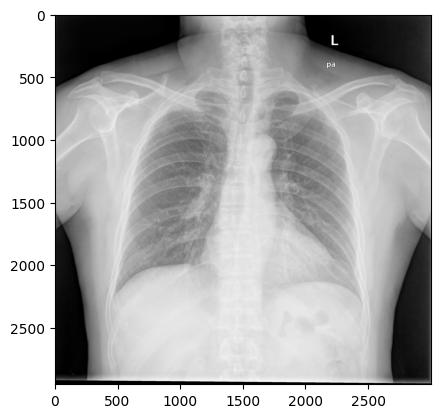

PNG
P
(2987, 2945)


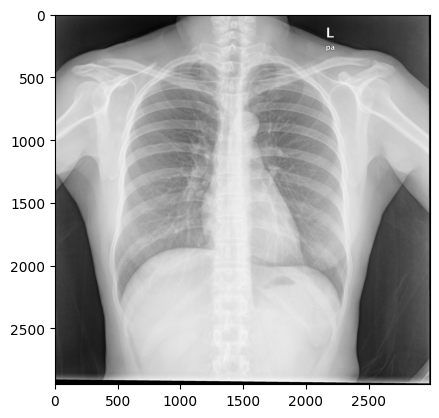

PNG
P
(3000, 2933)


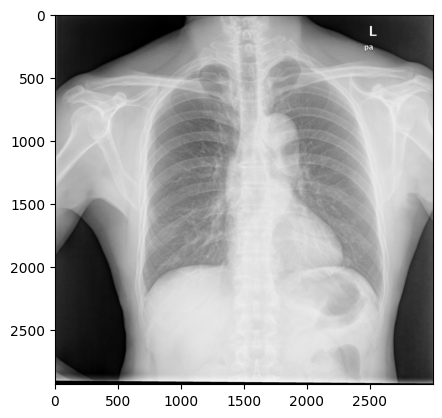

PNG
P
(3000, 2933)


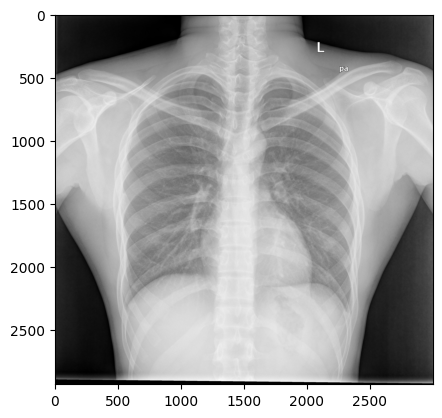

In [66]:
for i in range(1,5):
    image=img.open(metadata['path'][i])
    print(image.format)
    print(image.mode)
    print(image.size)
    plt.imshow(image)
    plt.show()
    
    
    

- We can instantly see that the image have different sizes, we'll need to standardize this.

## Display  Images

In [67]:
first_scan=img.open(metadata['path'][0])


In [68]:
print(type(first_scan))

<class 'PIL.PngImagePlugin.PngImageFile'>


In [69]:
#check image format
print(first_scan.format)

PNG


In [70]:
#print image mode
print(first_scan.mode)

P


In [71]:
#get image size
print(first_scan.size)

(3000, 2919)


In [72]:
#convert to grey scal 
processed_img=first_scan.convert("RGB")

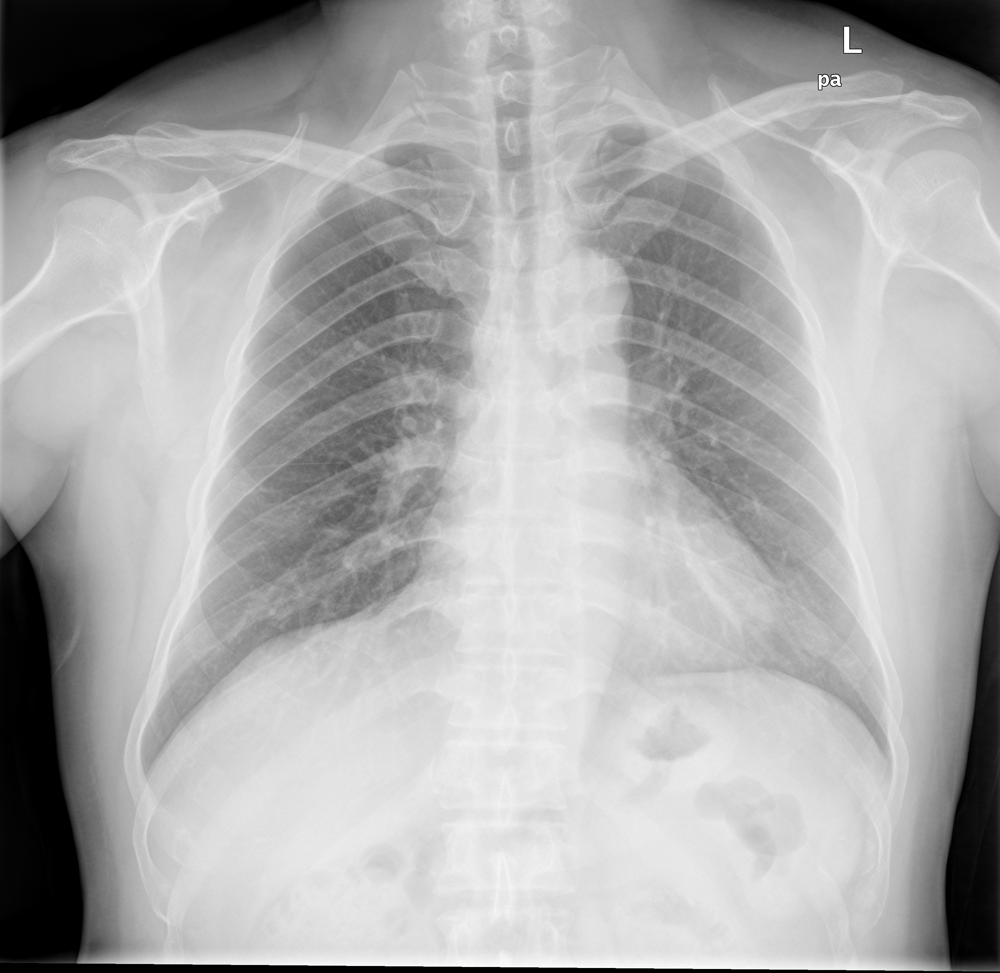

In [73]:
processed_img

In [74]:
processed_img.size

(3000, 2919)

## Image Preprocessing

In [75]:
# try cropping the image
def center_crop(img, new_width=None, new_height=None):        

    width = img.size[1]
    height = img.size[0]

    if new_width is None:
        new_width = min(width, height)

    if new_height is None:
        new_height = min(width, height)

    left = int(np.ceil((width - new_width) / 2))
    right = width - int(np.floor((width - new_width) / 2))

    top = int(np.ceil((height - new_height) / 2))
    bottom = height - int(np.floor((height - new_height) / 2))

    if len(img.size) == 2:
        # Crop the center of the image
        center_cropped_img = img.crop((left, top, right, bottom))
        # center_cropped_img = img[top:bottom, left:right]
    else:
        center_cropped_img = img[top:bottom, left:right, ...]

    return center_cropped_img

In [76]:
first_scan.size[0]

3000

In [77]:
cropped_image=center_crop(processed_img,2650,2100)

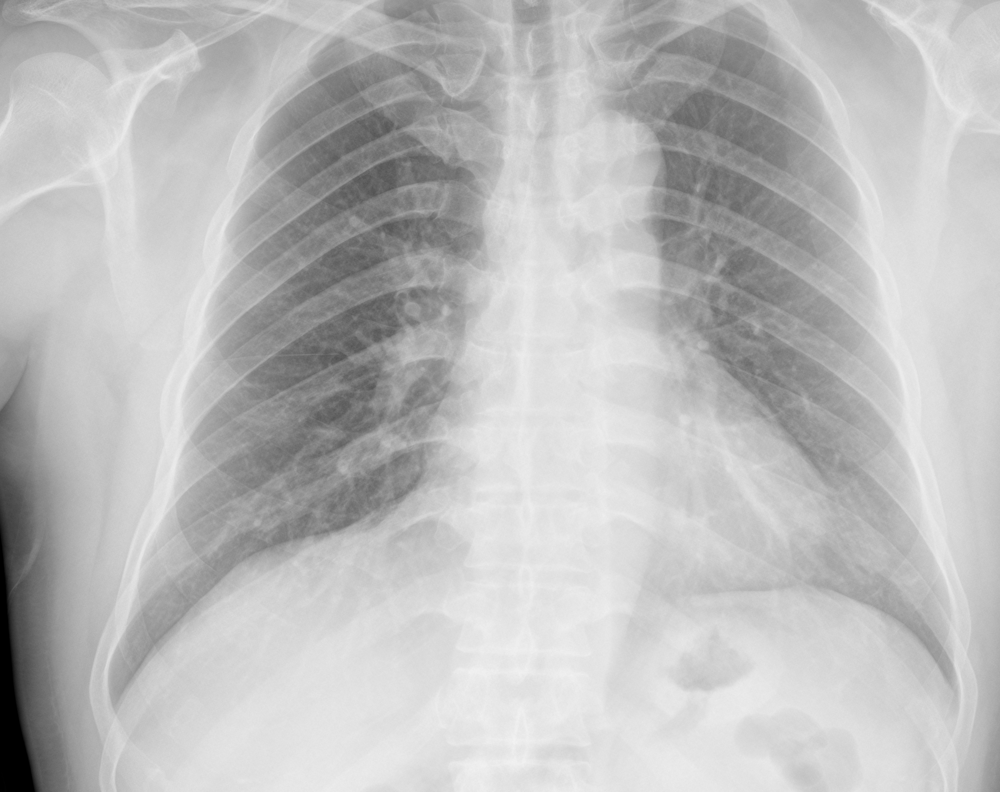

In [78]:
cropped_image

## Creating a data cleaning Pipeline

In [79]:
# take the image and convert into Grayscale first
def clean_pipeline(scan_file,width=2400,height=2000,scale="RGB"):
    #open file
    scan=img.open(scan_file).convert(scale)
    # print(scan.size)
    cropped_scan=scan.resize((width,height))
    # cropped_scan=center_crop(scan,width,height)
    
    return cropped_scan
    

## Converting Images to Numpy Arrays

In [80]:
def scan_to_numpy(img_path,img_width=512,img_height=512,grayscale=False):
    # transformed_img=[]
    
    if grayscale:
        image=clean_pipeline(img_path,img_width,img_height,scale="L")
        
    else:
        image=clean_pipeline(img_path,img_width,img_height,scale="RGB")
    
    prep_scan = np.array(image)
    # transformed_img.append(prep_scan)
    
    return prep_scan
    
    

In [81]:
metadata[:5]["path"]

0    ../data/unzipped_images/shenzhen_images/images...
1    ../data/unzipped_images/shenzhen_images/images...
2    ../data/unzipped_images/shenzhen_images/images...
3    ../data/unzipped_images/shenzhen_images/images...
4    ../data/unzipped_images/shenzhen_images/images...
Name: path, dtype: object

In [82]:
len(metadata)

662

In [83]:
r=metadata.head(5)

In [84]:
# scan_arrays=np.empty((0,))
scan_arrays=[]
for index,row in tq(enumerate(metadata['path']),total=len(metadata)):
    scan=scan_to_numpy(row)
    scan_arrays.append(scan)

100%|██████████| 662/662 [01:23<00:00,  7.95it/s]


In [85]:
scan_arrays[1]

array([[[ 62,  62,  62],
        [ 46,  46,  46],
        [ 34,  34,  34],
        ...,
        [ 62,  62,  62],
        [ 65,  65,  65],
        [ 68,  68,  68]],

       [[ 61,  61,  61],
        [ 45,  45,  45],
        [ 32,  32,  32],
        ...,
        [ 60,  60,  60],
        [ 63,  63,  63],
        [ 66,  66,  66]],

       [[ 60,  60,  60],
        [ 44,  44,  44],
        [ 30,  30,  30],
        ...,
        [ 60,  60,  60],
        [ 63,  63,  63],
        [ 64,  64,  64]],

       ...,

       [[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [109, 109, 109],
        [113, 113, 113],
        [127, 127, 127]],

       [[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [124, 124, 124],
        [125, 125, 125],
        [133, 133, 133]],

       [[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [ 25,  25,  25],
        [ 25,  25,  25],
        [ 26,  26,  26]]

In [86]:
#convert the array to a numpy array equivalent
scan_np=np.array(scan_arrays)

In [87]:
scan_np.shape

(662, 512, 512, 3)

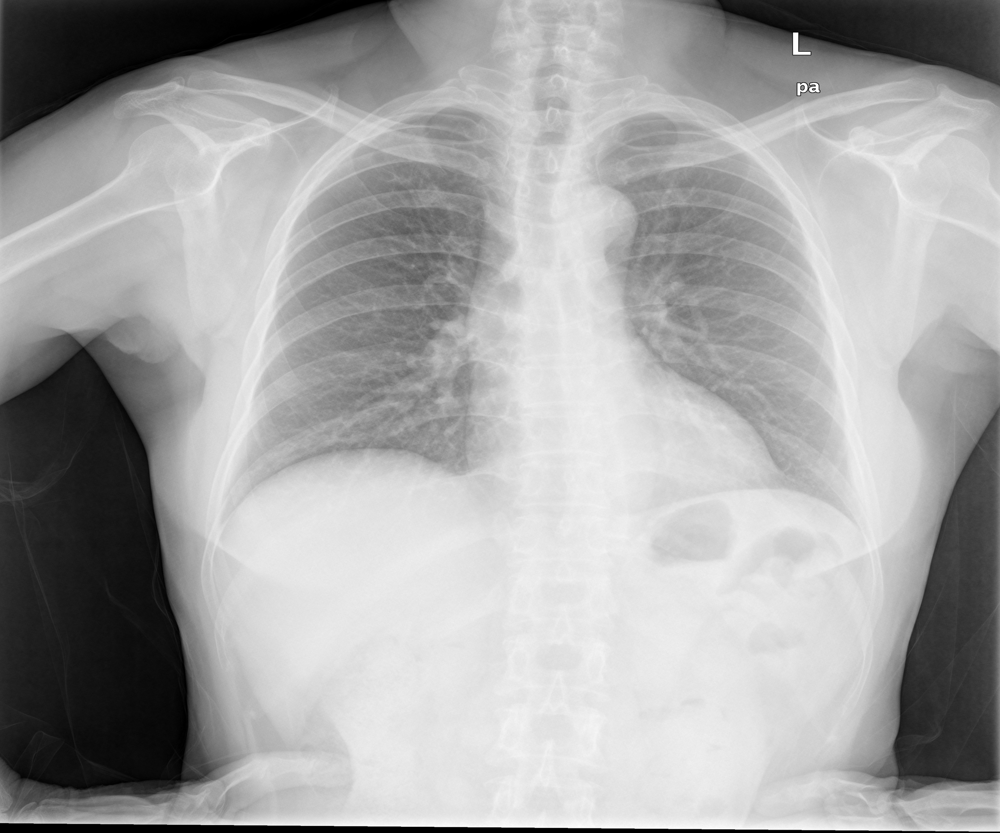

In [88]:
clean_pipeline(metadata['path'][9])

# displaying images

In [89]:
metadata[metadata['labels']=='abnormal'].index[0:5]

Index([326, 327, 328, 329, 330], dtype='int64')

In [90]:
first_five=metadata[metadata['labels'] == 'normal'][0:5].index
first_five_abn=metadata[metadata['labels'] == 'abnormal'][0:5].index

## healthy Images

In [91]:
scan_np[first_five][0].shape

(512, 512, 3)

<Figure size 1000x1000 with 0 Axes>

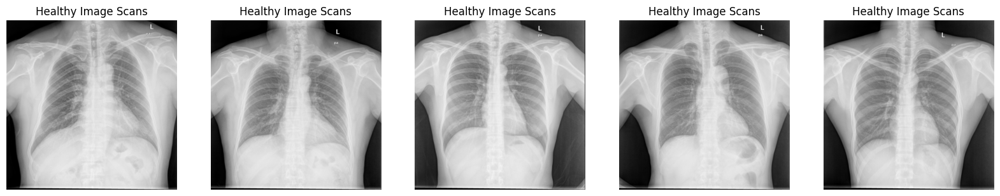

In [92]:
#use matplotlib to plot the images
plt.figure(figsize=(10,10))
fig,axes=plt.subplots(1,5,figsize=(20,20))

# images=[clean_pipeline(image) for image in first_five]
images=scan_np[first_five]

#display images in separate subplots
for i, ax in enumerate(axes):
    ax.imshow(images[i])
    ax.set_title("Healthy Image Scans")
    ax.axis("off")

In [93]:
# #use matplotlib to plot the images
# plt.figure(figsize=(10,10))
# fig,axes=plt.subplots(1,5,figsize=(20,20))

# images=[clean_pipeline(image) for image in first_five]

# #display images in separate subplots
# for i, ax in enumerate(axes):
#     ax.imshow(images[i])
#     ax.set_title("Healthy Image Scans")
#     ax.axis("off")

## TB Cases


<Figure size 1000x1000 with 0 Axes>

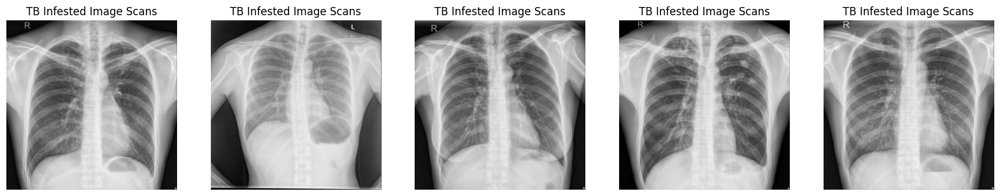

In [94]:
plt.figure(figsize=(10,10))
fig,axes=plt.subplots(1,5,figsize=(20,20))

# images=[clean_pipeline(image)for image in first_five_abn]
images=scan_np[first_five_abn]
#display images in separate subplots
for i, ax in enumerate(axes):
    ax.imshow(images[i])
    ax.set_title("TB Infested Image Scans")
    ax.axis("off")

# Modelling

## Data Splitting

In [95]:
scan_np.shape

(662, 512, 512, 3)

### Label Encoding

In [96]:
metadata["labels"].value_counts()

labels
abnormal    336
normal      326
Name: count, dtype: int64

In [97]:
X_train,X_test,y_train,y_test=train_test_split(scan_np,metadata["labels"].values,random_state=42)

In [98]:
le = LabelEncoder() 
train_labels=le.fit_transform(y_train) 
validation_labels= le.transform(y_test) 
 
print(y_train[1:15], train_labels[1:15])

['abnormal' 'abnormal' 'abnormal' 'abnormal' 'normal' 'normal' 'abnormal'
 'normal' 'normal' 'normal' 'normal' 'normal' 'abnormal' 'normal'] [0 0 0 0 1 1 0 1 1 1 1 1 0 1]


In [99]:
resnet = ResNet50(include_top=False, weights='imagenet', input_shape=(512,512,3))

In [100]:
resnet2=ResNet50(weights='imagenet')
resnet2.summary()

Model: "resnet50"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_4 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_4[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                       

In [101]:
resnet.summary()

Model: "resnet50"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_3 (InputLayer)        [(None, 512, 512, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 518, 518, 3)          0         ['input_3[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 256, 256, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 256, 256, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                       

In [102]:
# output = restnet.layers[-1].output
# output = layers.Flatten()(output)
# restnet = Model(restnet.input, outputs=output)
# for layer in restnet.layers:
#     layer.trainable = False
# restnet.summary()

In [103]:
for layer in resnet.layers[:143]:
    layer.trainable = False


In [104]:
for i,layer in enumerate(resnet.layers):
    print(i,layer.name," - ",layer.trainable)

0 input_3  -  False
1 conv1_pad  -  False
2 conv1_conv  -  False
3 conv1_bn  -  False
4 conv1_relu  -  False
5 pool1_pad  -  False
6 pool1_pool  -  False
7 conv2_block1_1_conv  -  False
8 conv2_block1_1_bn  -  False
9 conv2_block1_1_relu  -  False
10 conv2_block1_2_conv  -  False
11 conv2_block1_2_bn  -  False
12 conv2_block1_2_relu  -  False
13 conv2_block1_0_conv  -  False
14 conv2_block1_3_conv  -  False
15 conv2_block1_0_bn  -  False
16 conv2_block1_3_bn  -  False
17 conv2_block1_add  -  False
18 conv2_block1_out  -  False
19 conv2_block2_1_conv  -  False
20 conv2_block2_1_bn  -  False
21 conv2_block2_1_relu  -  False
22 conv2_block2_2_conv  -  False
23 conv2_block2_2_bn  -  False
24 conv2_block2_2_relu  -  False
25 conv2_block2_3_conv  -  False
26 conv2_block2_3_bn  -  False
27 conv2_block2_add  -  False
28 conv2_block2_out  -  False
29 conv2_block3_1_conv  -  False
30 conv2_block3_1_bn  -  False
31 conv2_block3_1_relu  -  False
32 conv2_block3_2_conv  -  False
33 conv2_block3_2_b

In [105]:
conv_output = resnet.get_layer("conv5_block3_out").output
gap_model=GlobalAveragePooling2D()(conv_output)
pred_model=Dense(1, activation='sigmoid')(gap_model)
# pred_output = resnet.get_layer("global_average_pooling2d").output
# pred_output=model.layers[-1].output
# model = Model(resnet.input, outputs=[conv_output, pred_model])

model = Model(resnet.input, outputs=pred_model)

#this shoud work
# model = Model(resnet.input, outputs= pred_model)

#remove incase we need to retrain the entire model
# Freeze the layers of the base model
# for layer in model.layers:
#     layer.trainable = False

model.compile(loss='binary_crossentropy',
              optimizer='adam',
              metrics=['accuracy', Precision(), Recall(), tf.keras.metrics.AUC(name='auc')])
model.summary()

# pred_ouptut = resnet.get_layer("predictions").output
# model = Model(res_model.input, outputs=[conv_ouptut, pred_layer])

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_3 (InputLayer)        [(None, 512, 512, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 518, 518, 3)          0         ['input_3[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 256, 256, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 256, 256, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                        

In [106]:
# model=GlobalAveragePooling2D()(restnet.output)
# model=Dense(1, activation='sigmoid')(model)
# model=Model(restnet.input,model)
# model.compile(loss='binary_crossentropy',
#               optimizer='adam',
#               metrics=['accuracy'])
# model.summary()


In [107]:
# model = Sequential()
# model.add(restnet)
# # model.add(Dense(512, activation='relu', input_dim=(512,512)))
# # model.add(Dropout(0.3))
# #add a globalaverge pooling layer
# model=GlobalMaxPooling2D()(model.output)
# # model.add(Dense(512, activation='relu'))
# # model.add(Dropout(0.3))
# model.add(Dense(1, activation='sigmoid'))
# model.compile(loss='binary_crossentropy',
#               optimizer='adam',
#               metrics=['accuracy'])
# model.summary()

In [108]:
# with io.StringIO() as s:
#     model.summary(print_fn=lambda x: s.write(x + "\n"))
#     model_summary = s.getvalue()

In [109]:
run["Model"]="Base Data Eng ResNet"
run["Task"]="Base Model RESNET Transfer"
run["max_epochs"]=3
run["training/model/summary"] = model.summary()
# with run.create_experiment():
history = model.fit(X_train,train_labels,
                                steps_per_epoch=10, 
                                epochs=3, 
                                verbose=1)
run['accuracy']=model.history.history['accuracy']
run['loss']= model.history.history['loss']
    

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_3 (InputLayer)        [(None, 512, 512, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 518, 518, 3)          0         ['input_3[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 256, 256, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 256, 256, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                        

In [110]:
# neptune_model = neptune.init_model(
#     name="DiagNet-24-v1.1",
#     key="MOD", 
#     project="blaise-papa/diagnosft-ai", 
#     api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiIxMWYwOTIzZi00ZWI1LTRkMTgtOTFmOC1mYTkxMDdmMDUzYWYifQ==", 
# )

In [111]:
# neptune_model['accuracy']=model.history.history['accuracy']
# neptune_model['loss']= model.history.history['loss']

In [112]:
model.history.history['accuracy']

[0.7701612710952759, 0.9233871102333069, 0.9596773982048035]

In [113]:
#predict
y=np.expand_dims(X_test[1],axis=0)

pred=model.predict(y)


1/1 [==============================] - 1s 785ms/step


In [114]:
i

174

In [115]:
# for idx in range(len(model.layers)):
#   print(model.get_layer(index = idx).name)

In [116]:
#get the prediction and the last output of the convolution block
# last_layer_weights=model.layers[-1].get_weights()[0]
# last_conv_output=model.layers["conv5_block3_out"]
# last_conv_output 


pred_model=Model(inputs=resnet.input,outputs=(model.layers[-4].output,model.layers[-1].output))

In [117]:
last_layer_weights=model.layers[-1].get_weights()[0]

In [118]:
#predict
y=np.expand_dims(X_test[3],axis=0)

last_conv_output,pred_out=pred_model.predict(y)

1/1 [==============================] - 1s 739ms/step


In [120]:
pred_out

array([[0.]], dtype=float32)

In [119]:
decode_predictions(pred_out)

ValueError: `decode_predictions` expects a batch of predictions (i.e. a 2D array of shape (samples, 1000)). Found array with shape: (1, 1)

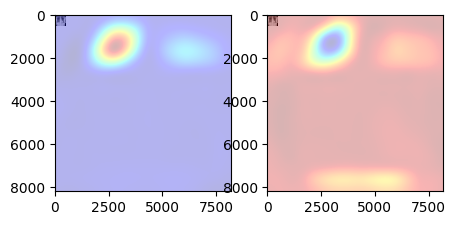

In [123]:
scale = 512 / 7
plt.figure(figsize=(16, 16))
for i in range(2):
    plt.subplot(6, 6, i + 1)
    plt.imshow(X_test[3])
    plt.imshow(scipy.ndimage.zoom(last_conv_output[0, :,:,i], zoom=(512, 512)), cmap='jet', alpha=0.3)

In [104]:
pred_out.shape

(1, 1)

In [82]:
last_conv_out=np.squeeze(last_conv_output)
last_conv_out

array([[[ 8.2662702e-02, -2.7782474e+00,  8.5973005e+00, ...,
         -1.9321140e+00, -4.6915131e+00, -2.0165324e-01],
        [ 9.6667886e-01, -3.0047417e+00,  7.4394031e+00, ...,
         -1.5895548e+00, -5.6359386e+00, -7.0215070e-01],
        [-3.3627832e-01, -3.2963612e+00,  3.4175329e+00, ...,
         -2.4471478e+00, -4.6429024e+00, -1.6662093e+00],
        ...,
        [-1.0315338e+00, -3.5025039e+00,  2.4540472e+00, ...,
         -2.9255419e+00, -4.2205777e+00, -1.4455056e+00],
        [-4.9011940e-01, -3.5987306e+00,  3.3977692e+00, ...,
         -2.5244372e+00, -5.1168547e+00, -6.6814530e-01],
        [-6.8427932e-01, -2.6935856e+00,  4.4162149e+00, ...,
         -4.5029664e-01, -4.2893305e+00, -2.6102555e-01]],

       [[-1.7235196e+00, -4.2027006e+00, -2.5612998e-01, ...,
         -4.1099982e+00, -3.4588976e+00, -3.5995495e-01],
        [-2.4731245e+00, -4.9614935e+00, -2.6759350e+00, ...,
         -6.3517466e+00, -3.4231327e+00, -1.1541353e+00],
        [-4.3246975e+00, 

In [105]:
pred_t=np.argmax(pred_out)

In [106]:
pred_t

0

In [92]:
pred_out

array([[0.]], dtype=float32)

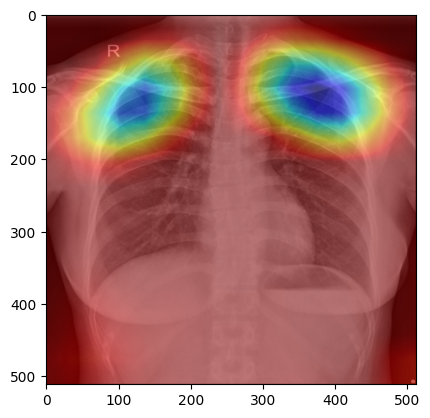

In [107]:
# spline interpolation to resize each filtered image to size of original image 
h = int(X_test[1].shape[0]/last_conv_out.shape[0])
# h=512
# w=512
w = int(X_test[1].shape[1]/last_conv_out.shape[1])
upsampled_last_conv_output = scipy.ndimage.zoom(last_conv_out, (h, w, 1), order=1) # dim: 224 x 224 x 2048

#Get the weights from the last layer for the prediction class
last_layer_weights_for_pred = last_layer_weights[:, pred_t] # dim: (2048,) 

#To generate the final heat map. 
#Reshape the upsampled last conv. output to n x filters and multiply (dot product) 
# with the last layer weigths for the prediction. 
# Reshape back to the image size for easy overlay onto the original image. 
heat_map = np.dot(upsampled_last_conv_output.reshape((512*512, 2048)), 
                  last_layer_weights_for_pred).reshape(512,512) # dim: 224 x 224

#We can fetch the actual class name for the prediction so we can add it as
# a title to our plot.
# with open('imagenet_classes.txt') as imagenet_classes_file:
#         imagenet_classes_dict = ast.literal_eval(imagenet_classes_file.read())
# predicted_class = imagenet_classes_dict[pred]   

#Plot original image with heatmap overlaid. 
fig, ax = plt.subplots()
ax.imshow(X_test[3])
ax.imshow(heat_map, cmap='jet', alpha=0.5)
# ax.set_title(predicted_class) 
plt.show()

In [94]:
y_test

array(['abnormal', 'abnormal', 'abnormal', 'abnormal', 'normal',
       'abnormal', 'abnormal', 'abnormal', 'normal', 'normal', 'normal',
       'normal', 'abnormal', 'abnormal', 'abnormal', 'normal', 'normal',
       'abnormal', 'normal', 'abnormal', 'normal', 'abnormal', 'abnormal',
       'abnormal', 'abnormal', 'normal', 'abnormal', 'normal', 'normal',
       'normal', 'abnormal', 'abnormal', 'abnormal', 'normal', 'normal',
       'normal', 'normal', 'abnormal', 'normal', 'abnormal', 'abnormal',
       'normal', 'normal', 'normal', 'abnormal', 'abnormal', 'abnormal',
       'normal', 'normal', 'abnormal', 'normal', 'abnormal', 'normal',
       'abnormal', 'normal', 'abnormal', 'normal', 'abnormal', 'abnormal',
       'normal', 'abnormal', 'normal', 'normal', 'abnormal', 'abnormal',
       'abnormal', 'abnormal', 'normal', 'normal', 'normal', 'normal',
       'normal', 'normal', 'normal', 'normal', 'normal', 'abnormal',
       'abnormal', 'normal', 'abnormal', 'abnormal', 'abnormal'

In [ ]:
def generate_gradcam(model, img_tensor, layer_name):
    grad_model = Model(inputs=[model.inputs], outputs=[model.get_layer(layer_name).output, model.output])

    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img_tensor)
        loss = predictions[:, np.argmax(predictions[0])]

    grads = tape.gradient(loss, conv_outputs)
    guided_grads = (tf.cast(conv_outputs > 0, 'float32') * tf.cast(grads > 0, 'float32') * grads)

    weights = tf.reduce_mean(guided_grads, axis=(1, 2))
    cam = tf.reduce_sum(tf.multiply(weights, conv_outputs[0]), axis=-1)
    cam = np.maximum(cam, 0)

    return cam

layer_name = 'conv5_block3_out'  # Replace with the name of the last activation layer
cam = generate_gradcam(model, i, layer_name)
heatmap = tf.keras.activations.relu(cam).numpy()
heatmap = np.uint8(255 * heatmap / np.max(heatmap))

jet = plt.get_cmap("jet")
jet_colors = jet(heatmap)

jet_heatmap = jet_colors[:, :, :3]
superimposed_img = jet_heatmap * 0.4 + img_array

plt.imshow(superimposed_img.astype('uint8'))
plt.show()

AttributeError: Exception encountered when calling layer 'model_2' (type Functional).

'numpy.int64' object has no attribute '_keras_mask'

Call arguments received by layer 'model_2' (type Functional):
  • inputs=0
  • training=None
  • mask=None

In [ ]:
import cv2

class GradCAM:
    def __init__(self, model, classIdx, layerName=None):
        # store the model, the class index used to measure the class
        # activation map, and the layer to be used when visualizing
        # the class activation map
        self.model = model
        self.classIdx = classIdx
        self.layerName = layerName
        # if the layer name is None, attempt to automatically find
        # the target output layer
        if self.layerName is None:
            self.layerName = self.find_target_layer()

    def find_target_layer(self):
        # attempt to find the final convolutional layer in the network
        # by looping over the layers of the network in reverse order
        for layer in reversed(self.model.layers):
            # check to see if the layer has a 4D output
            if len(layer.output_shape) == 4:
                return layer.name
        # otherwise, we could not find a 4D layer so the GradCAM
        # algorithm cannot be applied
        raise ValueError("Could not find 4D layer. Cannot apply GradCAM.")


    def compute_heatmap(self, image, eps=1e-8):
        # construct our gradient model by supplying (1) the inputs
        # to our pre-trained model, (2) the output of the (presumably)
        # final 4D layer in the network, and (3) the output of the
        # softmax activations from the model
        gradModel = Model(
            inputs=[self.model.inputs],
            outputs=[self.model.get_layer(self.layerName).output, self.model.output])

        # record operations for automatic differentiation
        with tf.GradientTape() as tape:
            # cast the image tensor to a float-32 data type, pass the
            # image through the gradient model, and grab the loss
            # associated with the specific class index
            inputs = tf.cast(image, tf.float32)
            (convOutputs, predictions) = gradModel(inputs)
            
            loss = predictions[:, tf.argmax(predictions[0])]
    
        # use automatic differentiation to compute the gradients
        grads = tape.gradient(loss, convOutputs)

        # compute the guided gradients
        castConvOutputs = tf.cast(convOutputs > 0, "float32")
        castGrads = tf.cast(grads > 0, "float32")
        guidedGrads = castConvOutputs * castGrads * grads
        # the convolution and guided gradients have a batch dimension
        # (which we don't need) so let's grab the volume itself and
        # discard the batch
        convOutputs = convOutputs[0]
        guidedGrads = guidedGrads[0]

        # compute the average of the gradient values, and using them
        # as weights, compute the ponderation of the filters with
        # respect to the weights
        weights = tf.reduce_mean(guidedGrads, axis=(0, 1))
        cam = tf.reduce_sum(tf.multiply(weights, convOutputs), axis=-1)

        # grab the spatial dimensions of the input image and resize
        # the output class activation map to match the input image
        # dimensions
        (w, h) = (image.shape[2], image.shape[1])
        heatmap = cv2.resize(cam.numpy(), (w, h))
        # normalize the heatmap such that all values lie in the range
        # [0, 1], scale the resulting values to the range [0, 255],
        # and then convert to an unsigned 8-bit integer
        numer = heatmap - np.min(heatmap)
        denom = (heatmap.max() - heatmap.min()) + eps
        heatmap = numer / denom
        heatmap = (heatmap * 255).astype("uint8")
        # return the resulting heatmap to the calling function
        return heatmap

    def overlay_heatmap(self, heatmap, image, alpha=0.5,
                        colormap=cv2.COLORMAP_VIRIDIS):
        # apply the supplied color map to the heatmap and then
        # overlay the heatmap on the input image
        heatmap = cv2.applyColorMap(heatmap, colormap)
        output = cv2.addWeighted(image, alpha, heatmap, 1 - alpha, 0)
        # return a 2-tuple of the color mapped heatmap and the output,
        # overlaid image
        return (heatmap, output)

In [ ]:
icam = GradCAM(model, i, 'conv5_block3_out') 
heatmap = icam.compute_heatmap(y)
heatmap = cv2.resize(heatmap, (512, 512))

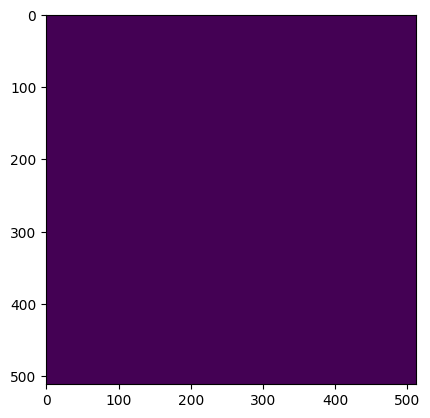

In [ ]:
plt.imshow(heatmap)

In [ ]:
conv_output = res_model.get_layer("conv5_block3_out").output
pred_ouptut = res_model.get_layer("predictions").output
model = Model(res_model.input, outputs=[conv_ouptut, pred_layer])